<a href="https://colab.research.google.com/github/lineeshakam/LLM-Loan-Confidence-Prediction/blob/main/demographicFactors.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import files
uploaded = files.upload()

Saving demographic_data.csv to demographic_data.csv


In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [3]:
demographic = pd.read_csv("demographic_data.csv")
demographic.head()

,County,State,State FIPS Code,County FIPS Code,fips,Total Population,Male Population,Female Population,Total Race Responses,White Alone,Black or African American Alone,Hispanic or Latino,Unnamed: 12,White Population,Black Population,Hispanic/Latino Population,Unnamed: 16,Unnamed: 17,Total
0,Autauga County,Alabama,1,1,1001,59285,28669,30616,59285,43616,11829,2188,NaN,0.735700,0.199528,0.036906,NaN,NaN,0.972135
1,Baldwin County,Alabama,1,3,1003,239945,117316,122629,239945,198721,19144,13393,NaN,0.828194,0.079785,0.055817,NaN,NaN,NaN
2,Barbour County,Alabama,1,5,1005,24757,12906,11851,24757,10891,11616,1490,NaN,0.439916,0.469201,0.060185,NaN,NaN,NaN
3,Bibb County,Alabama,1,7,1007,22152,11824,10328,22152,16634,4587,744,NaN,0.750903,0.207069,0.033586,NaN,NaN,NaN
4,Blount County,Alabama,1,9,1009,59292,29934,29358,59292,53062,747,5962,NaN,0.894927,0.012599,0.100553,NaN,NaN,NaN


In [4]:
ct_rows = demographic[demographic['State'] == 'Connecticut']
ct_rows.head()

,County,State,State FIPS Code,County FIPS Code,fips,Total Population,Male Population,Female Population,Total Race Responses,White Alone,Black or African American Alone,Hispanic or Latino,Unnamed: 12,White Population,Black Population,Hispanic/Latino Population,Unnamed: 16,Unnamed: 17,Total
309,Capitol Planning Region,Connecticut,9,110,9110,969029,474604,494425,969029,637789,120661,168439,NaN,0.658173,0.124517,0.173822,NaN,NaN,NaN
310,Greater Bridgeport Planning Region,Connecticut,9,120,9120,326296,160029,166267,326296,192722,41040,85034,NaN,0.590635,0.125775,0.260604,NaN,NaN,NaN
311,Lower Connecticut River Valley Planning Region,Connecticut,9,130,9130,174983,86295,88688,174983,143620,8921,13031,NaN,0.820765,0.050982,0.074470,NaN,NaN,NaN
312,Naugatuck Valley Planning Region,Connecticut,9,140,9140,452303,221077,231226,452303,302936,50684,86804,NaN,0.669763,0.112058,0.191916,NaN,NaN,NaN
313,Northeastern Connecticut Planning Region,Connecticut,9,150,9150,95829,47829,48000,95829,84910,1722,4839,NaN,0.886057,0.017970,0.050496,NaN,NaN,NaN


In [5]:
demographic = demographic.rename(columns={"fips": "id"})
demographic["id"] = demographic["id"].astype(str).str.zfill(5)

In [6]:
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt

# Load county shapefile (replace with your actual path or URL)
# Example using a common online source for US county GeoJSON
counties = gpd.read_file('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json')


In [7]:
counties.head()

,id,GEO_ID,STATE,COUNTY,NAME,LSAD,CENSUSAREA,geometry
0,01001,0500000US01001,01,001,Autauga,County,594.436,"POLYGON ((-86.49677 32.34444, -86.7179 32.4028..."
1,01009,0500000US01009,01,009,Blount,County,644.776,"POLYGON ((-86.5778 33.76532, -86.75914 33.8406..."
2,01017,0500000US01017,01,017,Chambers,County,596.531,"POLYGON ((-85.18413 32.87052, -85.12342 32.772..."
3,01021,0500000US01021,01,021,Chilton,County,692.854,"POLYGON ((-86.51734 33.02057, -86.51596 32.929..."
4,01033,0500000US01033,01,033,Colbert,County,592.619,"POLYGON ((-88.13999 34.5817, -88.13925 34.5878..."


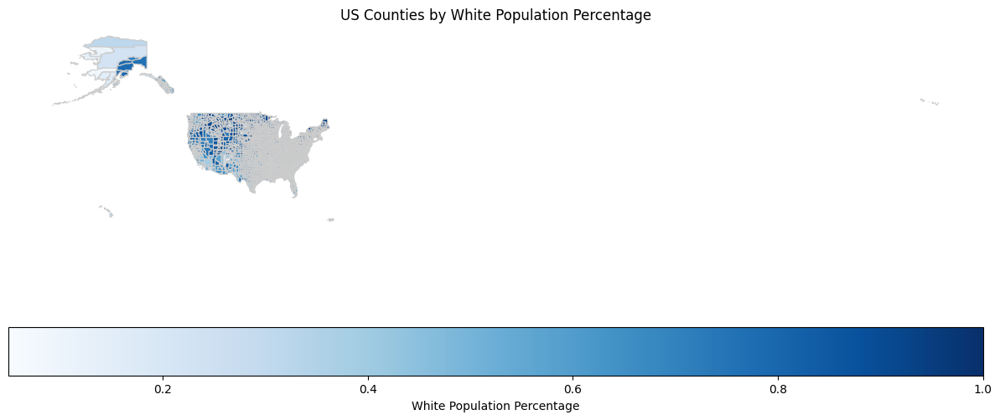

In [8]:

# Load your white population data (replace 'your_population_data.csv' and column names)
# Ensure this DataFrame has a 'FIPS' column matching the county GeoJSON's FIPS

# Merge the dataframes on FIPS code
# Assuming 'id' in counties is FIPS and 'FIPS' in population_data is FIPS
merged_data = counties.merge(demographic,on ='id', how='left')

# Create the choropleth map
fig, ax = plt.subplots(1, 1, figsize=(15, 10))
merged_data.plot(column='White Population', # Or 'White_Population_Count'
                 cmap='Blues', # Choose a suitable colormap
                 linewidth=0.8,
                 ax=ax,
                 edgecolor='0.8',
                 legend=True,
                 legend_kwds={'label': "White Population Percentage",
                              'orientation': "horizontal"})

ax.set_title('US Counties by White Population Percentage')
ax.set_axis_off()
plt.show()

In [9]:
import plotly.express as px
import pandas as pd
from urllib.request import urlopen
import json
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

In [10]:
fig = px.choropleth(
    merged_data,
    geojson=counties,
    locations='id',
    color='White Population',
    color_continuous_scale="Viridis",
    scope="usa",
    labels={'White Population':'White Population'},
    title="White Population by U.S. County"
)

fig.show()

In [11]:
merged_data.head()

,id,GEO_ID,STATE,COUNTY,NAME,LSAD,CENSUSAREA,geometry,County,State,...,White Alone,Black or African American Alone,Hispanic or Latino,Unnamed: 12,White Population,Black Population,Hispanic/Latino Population,Unnamed: 16,Unnamed: 17,Total
0,01001,0500000US01001,01,001,Autauga,County,594.436,"POLYGON ((-86.49677 32.34444, -86.7179 32.4028...",Autauga County,Alabama,...,43616.0,11829.0,2188.0,NaN,0.735700,0.199528,0.036906,NaN,NaN,0.972135
1,01009,0500000US01009,01,009,Blount,County,644.776,"POLYGON ((-86.5778 33.76532, -86.75914 33.8406...",Blount County,Alabama,...,53062.0,747.0,5962.0,NaN,0.894927,0.012599,0.100553,NaN,NaN,NaN
2,01017,0500000US01017,01,017,Chambers,County,596.531,"POLYGON ((-85.18413 32.87052, -85.12342 32.772...",Chambers County,Alabama,...,19089.0,13697.0,1270.0,NaN,0.554107,0.397591,0.036865,NaN,NaN,NaN
3,01021,0500000US01021,01,021,Chilton,County,692.854,"POLYGON ((-86.51734 33.02057, -86.51596 32.929...",Chilton County,Alabama,...,36815.0,4175.0,4489.0,NaN,0.809121,0.091758,0.098659,NaN,NaN,NaN
4,01033,0500000US01033,01,033,Colbert,County,592.619,"POLYGON ((-88.13999 34.5817, -88.13925 34.5878...",Colbert County,Alabama,...,44984.0,9103.0,1890.0,NaN,0.780322,0.157907,0.032785,NaN,NaN,NaN


In [12]:
fig = px.choropleth(
    merged_data,
    geojson=counties,
    locations='id',
    color='Black Population',
    color_continuous_scale="Viridis",
    scope="usa",
    labels={'Black Population':'Black Population Percentage'},
    title="Black Population by U.S. County"
)

fig.show()

In [15]:
fig = px.choropleth(
    merged_data,
    geojson=counties,
    locations='id',
    color='Hispanic/Latino Population',
    color_continuous_scale="Viridis",
    scope="usa",
    labels={'Hispanic/Latino Population':'Hispanic/Latino Population Percentage'},
    title="Hispanic/Latino Population by U.S. County"
)

fig.show()

In [16]:
merged_data["Non White Population"] = 1 - merged_data["White Population"]

In [17]:
fig = px.choropleth(
    merged_data,
    geojson=counties,
    locations='id',
    color='Non White Population',
    color_continuous_scale="Viridis",
    scope="usa",
    labels={'Non White Population':'Non White Population Percentage'},
    title="Non White Population by U.S. County"
)

fig.show()

#UNEMPLOYMENT

In [19]:
from google.colab import files
uploaded = files.upload()

Saving merged_data_unemployment_gpt-oss-120b.csv to merged_data_unemployment_gpt-oss-120b.csv


In [20]:
unemployment = pd.read_csv("merged_data_unemployment_gpt-oss-120b.csv")
unemployment.head()

,county_fips,county,unemployment_rate,rate_confidence,area_unemployment_rate,FIPS_Code,State,Area_Name,Attribute,Value,Unnamed: 10,Predicted-Actual
0,0,NaN,5.2,0.34,4.8,0,US,United States,Unemployment_rate_2023,3.6,NaN,1.6
1,1000,NaN,5.2,0.78,4.9,1000,AL,Alabama,Unemployment_rate_2023,2.5,NaN,2.7
2,1001,"Autauga County, AL",3.2,0.78,3.9,1001,AL,"Autauga County, AL",Unemployment_rate_2023,2.2,NaN,1.0
3,1003,"Baldwin County, AL",3.2,0.78,3.6,1003,AL,"Baldwin County, AL",Unemployment_rate_2023,2.3,NaN,0.9
4,1005,"Barbour County, AL",6.4,0.68,3.7,1005,AL,"Barbour County, AL",Unemployment_rate_2023,4.4,NaN,2.0


In [21]:
unemployment = unemployment.rename(columns={"county_fips": "id"})
unemployment["id"] = unemployment["id"].astype(str).str.zfill(5)

In [22]:
unemployment.head()

,id,county,unemployment_rate,rate_confidence,area_unemployment_rate,FIPS_Code,State,Area_Name,Attribute,Value,Unnamed: 10,Predicted-Actual
0,00000,NaN,5.2,0.34,4.8,0,US,United States,Unemployment_rate_2023,3.6,NaN,1.6
1,01000,NaN,5.2,0.78,4.9,1000,AL,Alabama,Unemployment_rate_2023,2.5,NaN,2.7
2,01001,"Autauga County, AL",3.2,0.78,3.9,1001,AL,"Autauga County, AL",Unemployment_rate_2023,2.2,NaN,1.0
3,01003,"Baldwin County, AL",3.2,0.78,3.6,1003,AL,"Baldwin County, AL",Unemployment_rate_2023,2.3,NaN,0.9
4,01005,"Barbour County, AL",6.4,0.68,3.7,1005,AL,"Barbour County, AL",Unemployment_rate_2023,4.4,NaN,2.0


In [23]:
unemploymentByRace = merged_data.merge(unemployment,on ='id', how='left')
unemploymentByRace

,id,GEO_ID,STATE,COUNTY,NAME,LSAD,CENSUSAREA,geometry,County,State_x,...,unemployment_rate,rate_confidence,area_unemployment_rate,FIPS_Code,State_y,Area_Name,Attribute,Value,Unnamed: 10,Predicted-Actual
0,01001,0500000US01001,01,001,Autauga,County,594.436,"POLYGON ((-86.49677 32.34444, -86.7179 32.4028...",Autauga County,Alabama,...,3.2,0.78,3.9,1001.0,AL,"Autauga County, AL",Unemployment_rate_2023,2.2,NaN,1.0
1,01009,0500000US01009,01,009,Blount,County,644.776,"POLYGON ((-86.5778 33.76532, -86.75914 33.8406...",Blount County,Alabama,...,4.3,0.77,3.6,1009.0,AL,"Blount County, AL",Unemployment_rate_2023,2.1,NaN,2.2
2,01017,0500000US01017,01,017,Chambers,County,596.531,"POLYGON ((-85.18413 32.87052, -85.12342 32.772...",Chambers County,Alabama,...,4.6,0.74,3.3,1017.0,AL,"Chambers County, AL",Unemployment_rate_2023,2.4,NaN,2.2
3,01021,0500000US01021,01,021,Chilton,County,692.854,"POLYGON ((-86.51734 33.02057, -86.51596 32.929...",Chilton County,Alabama,...,4.2,0.78,3.6,1021.0,AL,"Chilton County, AL",Unemployment_rate_2023,2.2,NaN,2.0
4,01033,0500000US01033,01,033,Colbert,County,592.619,"POLYGON ((-88.13999 34.5817, -88.13925 34.5878...",Colbert County,Alabama,...,4.3,0.81,3.6,1033.0,AL,"Colbert County, AL",Unemployment_rate_2023,2.9,NaN,1.4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3216,51001,0500000US51001,51,001,Accomack,County,449.496,"MULTIPOLYGON (((-75.24227 38.02721, -75.29687 ...",Accomack County,Virginia,...,5.8,0.78,3.9,51001.0,VA,"Accomack County, VA",Unemployment_rate_2023,3.5,NaN,2.3
3217,51021,0500000US51021,51,021,Bland,County,357.725,"POLYGON ((-81.2251 37.23487, -81.20477 37.2430...",Bland County,Virginia,...,5.3,0.66,3.8,51021.0,VA,"Bland County, VA",Unemployment_rate_2023,3.0,NaN,2.3
3218,51027,0500000US51027,51,027,Buchanan,County,502.763,"POLYGON ((-81.9683 37.5378, -81.92787 37.51212...",Buchanan County,Virginia,...,7.2,0.65,3.6,51027.0,VA,"Buchanan County, VA",Unemployment_rate_2023,4.4,NaN,2.8
3219,51037,0500000US51037,51,037,Charlotte,County,475.271,"POLYGON ((-78.44332 37.0794, -78.49303 36.8912...",Charlotte County,Virginia,...,5.2,0.78,3.2,51037.0,VA,"Charlotte County, VA",Unemployment_rate_2023,3.5,NaN,1.7


In [24]:
unemploymentByRace["Majority"] = unemploymentByRace["White Population"].apply(
    lambda x: "White" if x >= 0.5 else "Other"
)

In [27]:
white = unemploymentByRace[unemploymentByRace['Majority'] == 'White']
other = unemploymentByRace[unemploymentByRace['Majority'] == 'Other']

In [28]:
fig = px.choropleth(
    white,
    geojson=counties,
    locations='id',
    color='Predicted',
    color_continuous_scale="Viridis",
    scope="usa",
    labels={'Difference in Predicted - Actual':'Predicted - Actual'},
    title="Unemployment Estimates for Majority White Counties gpt-oss-120b"
)

fig.show()

ValueError: Value of 'color' is not the name of a column in 'data_frame'. Expected one of ['id', 'GEO_ID', 'STATE', 'COUNTY', 'NAME', 'LSAD', 'CENSUSAREA', 'geometry', 'County', 'State_x', 'State FIPS Code', 'County FIPS Code', 'Total Population', 'Male Population', 'Female Population', 'Total Race Responses', 'White Alone', 'Black or African American Alone', 'Hispanic or Latino', 'Unnamed: 12', 'White Population', 'Black Population', 'Hispanic/Latino Population', 'Unnamed: 16', 'Unnamed: 17', 'Total', 'Non White Population', 'county', 'unemployment_rate', 'rate_confidence', 'area_unemployment_rate', 'FIPS_Code', 'State_y', 'Area_Name', 'Attribute', 'Value', 'Unnamed: 10', 'Predicted-Actual', 'Majority'] but received: Predicted

In [29]:
fig = px.choropleth(
    white,
    geojson=counties,
    locations='id',
    color='Predicted-Actual',
    color_continuous_scale="Viridis",
    scope="usa",
    labels={'Difference in Predicted - Actual':'Predicted - Actual'},
    title="Unemployment Estimates for Majority White Counties gpt-oss-120b"
)

fig.show()

In [30]:
fig = px.choropleth(
    other,
    geojson=counties,
    locations='id',
    color='Predicted-Actual',
    color_continuous_scale="Viridis",
    scope="usa",
    labels={'Difference in Predicted - Actual':'Predicted - Actual'},
    title="Unemployment Estimates for Majority Non-White Counties gpt-oss-120b"
)

fig.show()

In [38]:
###spatial autocorrelation

from shapely.geometry import shape

#convert to geograme
geo_df = gpd.GeoDataFrame(merged_data, geometry="geometry", crs="EPSG:4326")
geo_proj = geo_df.to_crs(5070)
geo_proj["centroid"] = geo_proj.geometry.centroid
cent_ll = geo_proj["centroid"].to_crs(4326)
geo_df["x"] = cent_ll.x
geo_df["y"] = cent_ll.y

print(geo_df[["id", "x", "y"]].head())

      id          x          y
0  01001 -86.641189  32.536193
1  01009 -86.569942  33.985246
2  01017 -85.389884  32.911607
3  01021 -86.719860  32.850261
4  01033 -87.805837  34.701906


In [43]:

geo_df = geo_df.copy()

bias_lookup = (
    unemploymentByRace[["id", "Predicted-Actual"]]
    .dropna(subset=["Predicted-Actual"])
    .set_index("id")["Predicted-Actual"]
    .astype(float)          # ensure numeric
)

geo_df.loc[:, "bias"] = geo_df["id"].map(bias_lookup)
#geo_df.loc[:, "bias"] = geo_df["bias"].astype(float)
geo_df = geo_df.dropna(subset=['bias', 'x', 'y'])
print(geo_df.columns.tolist())

['id', 'GEO_ID', 'STATE', 'COUNTY', 'NAME', 'LSAD', 'CENSUSAREA', 'geometry', 'County', 'State', 'State FIPS Code', 'County FIPS Code', 'Total Population', 'Male Population', 'Female Population', 'Total Race Responses', 'White Alone', 'Black or African American Alone', 'Hispanic or Latino', 'Unnamed: 12', 'White Population', 'Black Population', 'Hispanic/Latino Population', 'Unnamed: 16', 'Unnamed: 17', 'Total', 'Non White Population', 'x', 'y', 'bias']


In [44]:
##k-means clustering

from sklearn.cluster import KMeans
import numpy as np

X = geo_df[['x', 'y', 'bias']].copy()
X = (X - X.mean()) / X.std()

kmeans = KMeans(n_clusters=6, random_state=42)
geo_df['cluster'] = kmeans.fit_predict(X)

In [45]:
import plotly.express as px

fig = px.choropleth(
    geo_df,
    geojson=counties,
    locations='id',
    color='cluster',
    color_continuous_scale='Turbo',
    scope='usa',
    title="Geographic Clusters of Model Bias by County"
)
fig.show()

In [46]:
cluster_summary = geo_df.groupby('cluster')['bias'].mean().sort_values()
print(cluster_summary)

cluster
1   -0.044056
2    0.361480
4    0.974354
5    1.547571
3    1.639196
0    2.883446
Name: bias, dtype: float64


In [52]:
!pip install esda splot

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.3/61.3 kB 3.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 882.2/882.2 kB 13.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 389.9/389.9 kB 14.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 325.7/325.7 kB 11.0 MB/s eta 0:00:00


/usr/local/lib/python3.12/dist-packages/libpysal/weights/contiguity.py:347: UserWarning:

The weights matrix is not fully connected: 
 There are 4 disconnected components.
 There are 3 islands with ids: 2877, 2925, 3106.

/usr/local/lib/python3.12/dist-packages/esda/moran.py:1354: RuntimeWarning:

invalid value encountered in divide



('WARNING: ', 2877, ' is an island (no neighbors)')
('WARNING: ', 2925, ' is an island (no neighbors)')
('WARNING: ', 3106, ' is an island (no neighbors)')


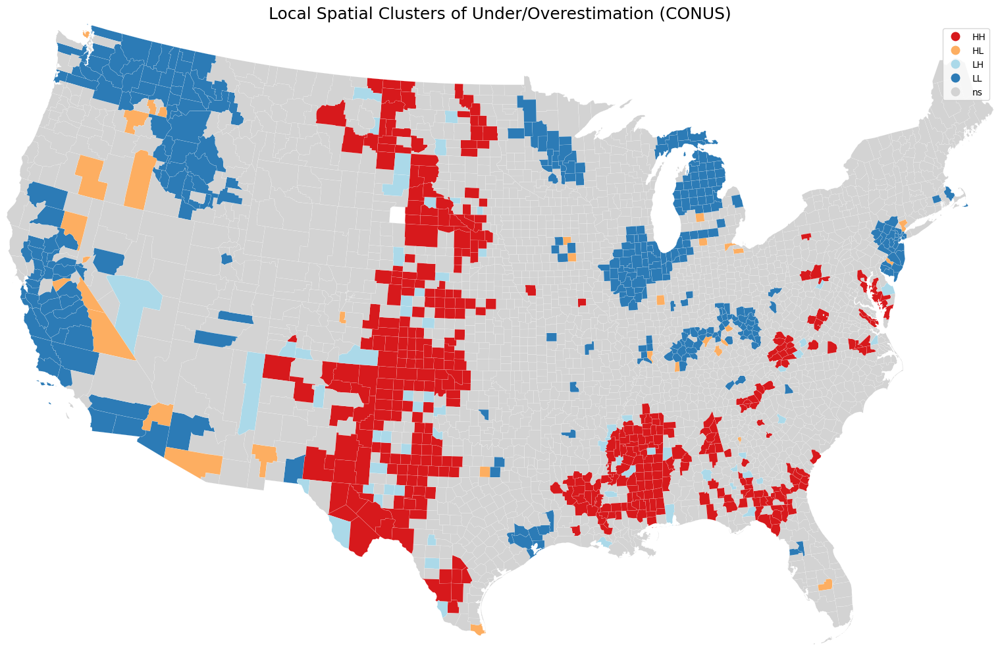

In [57]:
import libpysal, esda
from splot.esda import lisa_cluster
import matplotlib.pyplot as plt

conus = geo_df[~geo_df["STATE"].isin(["02", "15", "72"])].copy()

conus = conus.to_crs(5070)

w = libpysal.weights.Queen.from_dataframe(conus, use_index=True)
w.transform = "r"
lisa = esda.Moran_Local(conus["bias"], w)

fig, ax = plt.subplots(figsize=(16, 10))
lisa_cluster(lisa, conus, ax=ax, legend=True, p=0.05)
minx, miny, maxx, maxy = conus.total_bounds
ax.set_xlim(minx, maxx); ax.set_ylim(miny, maxy)
ax.set_title("Local Spatial Clusters of Under/Overestimation (CONUS)", fontsize=18)
ax.set_axis_off()
plt.tight_layout()
plt.show()

#OVERALL DEBT

In [58]:
from google.colab import files
uploaded = files.upload()

Saving merged_data_dti_gpt-oss-120b.csv.csv to merged_data_dti_gpt-oss-120b.csv.csv


In [59]:
debtIncome = pd.read_csv("merged_data_dti_gpt-oss-120b.csv.csv")
debtIncome.head()

,county_fips,county,dti_ratio,loan_confidence,area_median_dti,error,year,qtr,area_fips,low,high,mean_col,Difference
0,1069,Houston Al,0.42,0.732,0.38,NaN,2025,1,1069,1.19,1.37,1.28,-0.86
1,1023,Choctaw Al,0.42,0.670,0.38,NaN,2025,1,1023,1.01,1.19,1.10,-0.68
2,1005,Barbour Al,0.42,0.730,0.38,NaN,2025,1,1005,1.01,1.19,1.10,-0.68
3,1107,Pickens Al,0.38,0.460,0.33,NaN,2025,1,1107,1.58,1.82,1.70,-1.32
4,1033,Colbert Al,0.42,0.780,0.34,NaN,2025,1,1033,1.01,1.19,1.10,-0.68


In [60]:
debtIncome = debtIncome.rename(columns={"county_fips": "id"})
debtIncome["id"] = debtIncome["id"].astype(str).str.zfill(5)

In [61]:
debtIncomeByRace = merged_data.merge(debtIncome,on ='id', how='left')
debtIncomeByRace

,id,GEO_ID,STATE,COUNTY,NAME,LSAD,CENSUSAREA,geometry,County,State,...,loan_confidence,area_median_dti,error,year,qtr,area_fips,low,high,mean_col,Difference
0,01001,0500000US01001,01,001,Autauga,County,594.436,"POLYGON ((-86.49677 32.34444, -86.7179 32.4028...",Autauga County,Alabama,...,0.630,0.360,NaN,2025.0,1.0,1001.0,2.61,3.43,3.020,-2.600
1,01009,0500000US01009,01,009,Blount,County,644.776,"POLYGON ((-86.5778 33.76532, -86.75914 33.8406...",Blount County,Alabama,...,0.630,1.450,NaN,2025.0,1.0,1009.0,3.43,3.43,3.430,-1.650
2,01017,0500000US01017,01,017,Chambers,County,596.531,"POLYGON ((-85.18413 32.87052, -85.12342 32.772...",Chambers County,Alabama,...,0.710,1.340,NaN,2025.0,1.0,1017.0,1.58,1.82,1.700,-0.130
3,01021,0500000US01021,01,021,Chilton,County,692.854,"POLYGON ((-86.51734 33.02057, -86.51596 32.929...",Chilton County,Alabama,...,0.672,0.389,NaN,2025.0,1.0,1021.0,2.61,3.43,3.020,-2.547
4,01033,0500000US01033,01,033,Colbert,County,592.619,"POLYGON ((-88.13999 34.5817, -88.13925 34.5878...",Colbert County,Alabama,...,0.780,0.340,NaN,2025.0,1.0,1033.0,1.01,1.19,1.100,-0.680
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3216,51001,0500000US51001,51,001,Accomack,County,449.496,"MULTIPOLYGON (((-75.24227 38.02721, -75.29687 ...",Accomack County,Virginia,...,0.460,0.340,NaN,2025.0,1.0,51001.0,1.01,1.19,1.100,-0.710
3217,51021,0500000US51021,51,021,Bland,County,357.725,"POLYGON ((-81.2251 37.23487, -81.20477 37.2430...",Bland County,Virginia,...,0.680,0.360,NaN,2025.0,1.0,51021.0,0.00,0.78,0.390,0.030
3218,51027,0500000US51027,51,027,Buchanan,County,502.763,"POLYGON ((-81.9683 37.5378, -81.92787 37.51212...",Buchanan County,Virginia,...,0.780,0.300,NaN,2025.0,1.0,51027.0,1.01,1.19,1.100,-0.760
3219,51037,0500000US51037,51,037,Charlotte,County,475.271,"POLYGON ((-78.44332 37.0794, -78.49303 36.8912...",Charlotte County,Virginia,...,0.730,0.940,NaN,2025.0,1.0,51037.0,1.82,2.15,1.985,-0.715


In [62]:
debtIncomeByRace["Majority"] = debtIncomeByRace["White Population"].apply(
    lambda x: "White" if x >= 0.5 else "Other"
)

In [63]:
white = debtIncomeByRace[debtIncomeByRace['Majority'] == 'White']
other = debtIncomeByRace[debtIncomeByRace['Majority'] == 'Other']

In [64]:
fig = px.choropleth(
    white,
    geojson=counties,
    locations='id',
    color='Difference',
    color_continuous_scale="Viridis",
    scope="usa",
    labels={'Difference in Predicted - Actual':'Predicted - Actual'},
    title="Debt Income Estimates for Majority White Counties gpt-oss-120b"
)

fig.show()

In [ ]:
fig = px.choropleth(
    other,
    geojson=counties,
    locations='id',
    color='Difference',
    color_continuous_scale="Viridis",
    scope="usa",
    labels={'Difference in Predicted - Actual':'Predicted - Actual'},
    title="Debt Income Estimates for Majority Non-White Counties gpt-oss-120b"
)

fig.show()

In [ ]:

from shapely.geometry import shape

#convert to geograme
geo_df = gpd.GeoDataFrame(merged_data, geometry="geometry", crs="EPSG:4326")
geo_proj = geo_df.to_crs(5070)
geo_proj["centroid"] = geo_proj.geometry.centroid
cent_ll = geo_proj["centroid"].to_crs(4326)
geo_df["x"] = cent_ll.x
geo_df["y"] = cent_ll.y

print(geo_df[["id", "x", "y"]].head())

In [66]:
geo_df = geo_df.copy()

bias_lookup = (
    debtIncomeByRace[["id", "Difference"]]
    .dropna(subset=["Difference"])
    .set_index("id")["Difference"]
    .astype(float)          # ensure numeric
)

geo_df.loc[:, "bias"] = geo_df["id"].map(bias_lookup)
#geo_df.loc[:, "bias"] = geo_df["bias"].astype(float)
geo_df = geo_df.dropna(subset=['bias', 'x', 'y'])
print(geo_df.columns.tolist())

['id', 'GEO_ID', 'STATE', 'COUNTY', 'NAME', 'LSAD', 'CENSUSAREA', 'geometry', 'County', 'State', 'State FIPS Code', 'County FIPS Code', 'Total Population', 'Male Population', 'Female Population', 'Total Race Responses', 'White Alone', 'Black or African American Alone', 'Hispanic or Latino', 'Unnamed: 12', 'White Population', 'Black Population', 'Hispanic/Latino Population', 'Unnamed: 16', 'Unnamed: 17', 'Total', 'Non White Population', 'x', 'y', 'bias', 'cluster']


In [67]:
##k-means clustering

from sklearn.cluster import KMeans
import numpy as np

X = geo_df[['x', 'y', 'bias']].copy()
X = (X - X.mean()) / X.std()

kmeans = KMeans(n_clusters=6, random_state=42)
geo_df['cluster'] = kmeans.fit_predict(X)

In [68]:
import plotly.express as px

fig = px.choropleth(
    geo_df,
    geojson=counties,
    locations='id',
    color='cluster',
    color_continuous_scale='Turbo',
    scope='usa',
    title="Geographic Clusters of Model Bias by County"
)
fig.show()

In [69]:
cluster_summary = geo_df.groupby('cluster')['bias'].mean().sort_values()
print(cluster_summary)

cluster
1   -2.590168
4   -1.882269
2   -0.959529
0   -0.911269
3   -0.694347
5   -0.451481
Name: bias, dtype: float64


/usr/local/lib/python3.12/dist-packages/libpysal/weights/contiguity.py:347: UserWarning:

The weights matrix is not fully connected: 
 There are 4 disconnected components.
 There are 3 islands with ids: 2877, 2925, 3106.

/usr/local/lib/python3.12/dist-packages/esda/moran.py:1354: RuntimeWarning:

invalid value encountered in divide



('WARNING: ', 2877, ' is an island (no neighbors)')
('WARNING: ', 2925, ' is an island (no neighbors)')
('WARNING: ', 3106, ' is an island (no neighbors)')


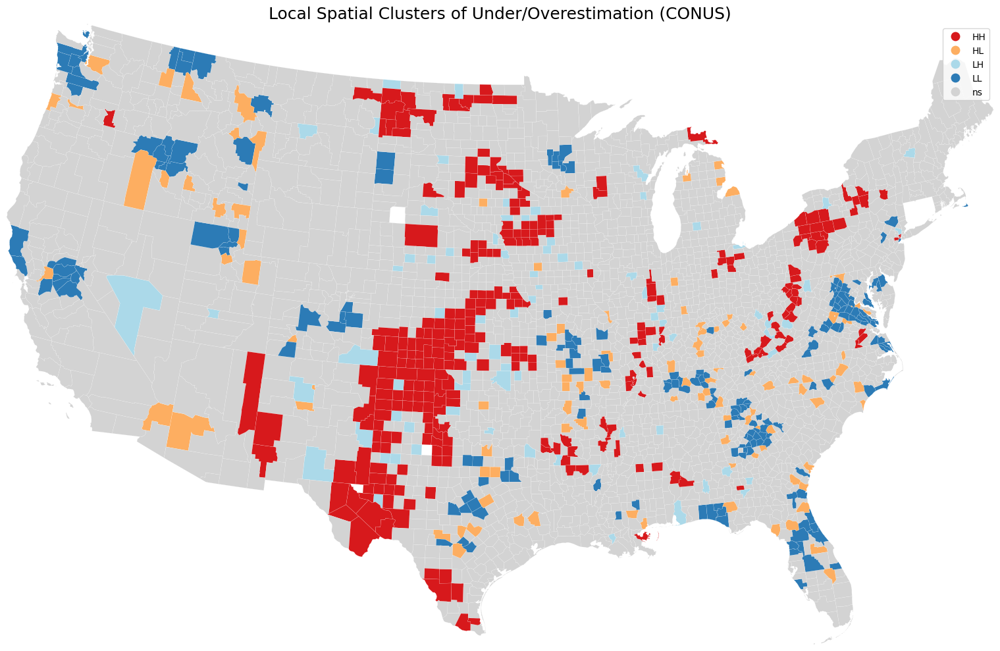

Global Moran’s I: 0.1887518933827909 p: 0.0001


In [71]:
import libpysal, esda
from splot.esda import lisa_cluster
import matplotlib.pyplot as plt

conus = geo_df[~geo_df["STATE"].isin(["02", "15", "72"])].copy()

conus = conus.to_crs(5070)

w = libpysal.weights.Queen.from_dataframe(conus, use_index=True)
w.transform = "r"
lisa = esda.Moran_Local(conus["bias"], w)

fig, ax = plt.subplots(figsize=(16, 10))
lisa_cluster(lisa, conus, ax=ax, legend=True, p=0.05)
minx, miny, maxx, maxy = conus.total_bounds
ax.set_xlim(minx, maxx); ax.set_ylim(miny, maxy)
ax.set_title("Local Spatial Clusters of Under/Overestimation (CONUS)", fontsize=18)
ax.set_axis_off()
plt.tight_layout()
plt.show()

moran = esda.Moran(conus["bias"].values, w, permutations=9999)

print("Global Moran’s I:", moran.I, "p:", moran.p_sim)

#CREDIT SCORE

In [72]:
from google.colab import files
uploaded = files.upload()

Saving merged_fips_data_gpt-oss-120b.csv to merged_fips_data_gpt-oss-120b.csv


In [73]:
creditScore = pd.read_csv("merged_fips_data_gpt-oss-120b.csv")
creditScore.head()

,FIPS,credit_score,par_state,par_county,county_name,kid_race,county_fips,county,predicted_credit_score,loan_confidence,Difference
0,1001,656.947200,1,1,Autauga,Pooled,1001,"Autauga County, AL",715,0.680,58.052800
1,1003,667.065871,1,3,Baldwin,Pooled,1003,"Baldwin County, AL",680,0.450,12.934129
2,1005,650.661562,1,5,Barbour,Pooled,1005,"Barbour County, AL",660,0.420,9.338438
3,1007,640.017483,1,7,Bibb,Pooled,1007,"Bibb County, AL",660,0.450,19.982517
4,1009,661.909095,1,9,Blount,Pooled,1009,"Blount County, AL",672,0.423,10.090905


In [74]:
creditScore = creditScore.rename(columns={"FIPS": "id"})
creditScore["id"] = creditScore["id"].astype(str).str.zfill(5)

In [75]:
creditScore.head()

,id,credit_score,par_state,par_county,county_name,kid_race,county_fips,county,predicted_credit_score,loan_confidence,Difference
0,01001,656.947200,1,1,Autauga,Pooled,1001,"Autauga County, AL",715,0.680,58.052800
1,01003,667.065871,1,3,Baldwin,Pooled,1003,"Baldwin County, AL",680,0.450,12.934129
2,01005,650.661562,1,5,Barbour,Pooled,1005,"Barbour County, AL",660,0.420,9.338438
3,01007,640.017483,1,7,Bibb,Pooled,1007,"Bibb County, AL",660,0.450,19.982517
4,01009,661.909095,1,9,Blount,Pooled,1009,"Blount County, AL",672,0.423,10.090905


In [76]:
creditScoreByRace = merged_data.merge(creditScore,on ='id', how='left')
creditScoreByRace

,id,GEO_ID,STATE,COUNTY,NAME,LSAD,CENSUSAREA,geometry,County,State,...,credit_score,par_state,par_county,county_name,kid_race,county_fips,county,predicted_credit_score,loan_confidence,Difference
0,01001,0500000US01001,01,001,Autauga,County,594.436,"POLYGON ((-86.49677 32.34444, -86.7179 32.4028...",Autauga County,Alabama,...,656.947200,1.0,1.0,Autauga,Pooled,1001.0,"Autauga County, AL",715.0,0.680,58.052800
1,01009,0500000US01009,01,009,Blount,County,644.776,"POLYGON ((-86.5778 33.76532, -86.75914 33.8406...",Blount County,Alabama,...,661.909095,1.0,9.0,Blount,Pooled,1009.0,"Blount County, AL",672.0,0.423,10.090905
2,01017,0500000US01017,01,017,Chambers,County,596.531,"POLYGON ((-85.18413 32.87052, -85.12342 32.772...",Chambers County,Alabama,...,636.839678,1.0,17.0,Chambers,Pooled,1017.0,"Chambers County, AL",672.0,0.342,35.160322
3,01021,0500000US01021,01,021,Chilton,County,692.854,"POLYGON ((-86.51734 33.02057, -86.51596 32.929...",Chilton County,Alabama,...,649.721974,1.0,21.0,Chilton,Pooled,1021.0,"Chilton County, AL",672.0,0.423,22.278026
4,01033,0500000US01033,01,033,Colbert,County,592.619,"POLYGON ((-88.13999 34.5817, -88.13925 34.5878...",Colbert County,Alabama,...,655.549660,1.0,33.0,Colbert,Pooled,1033.0,"Colbert County, AL",672.0,0.417,16.450340
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3216,51001,0500000US51001,51,001,Accomack,County,449.496,"MULTIPOLYGON (((-75.24227 38.02721, -75.29687 ...",Accomack County,Virginia,...,662.174967,51.0,1.0,Accomack,Pooled,51001.0,"Accomack County, VA",660.0,0.321,-2.174967
3217,51021,0500000US51021,51,021,Bland,County,357.725,"POLYGON ((-81.2251 37.23487, -81.20477 37.2430...",Bland County,Virginia,...,678.510268,51.0,21.0,Bland,Pooled,51021.0,"Bland County, VA",660.0,0.340,-18.510268
3218,51027,0500000US51027,51,027,Buchanan,County,502.763,"POLYGON ((-81.9683 37.5378, -81.92787 37.51212...",Buchanan County,Virginia,...,667.275590,51.0,27.0,Buchanan,Pooled,51027.0,"Buchanan County, VA",682.0,0.570,14.724410
3219,51037,0500000US51037,51,037,Charlotte,County,475.271,"POLYGON ((-78.44332 37.0794, -78.49303 36.8912...",Charlotte County,Virginia,...,661.657433,51.0,37.0,Charlotte,Pooled,51037.0,"Charlotte County, VA",690.0,0.570,28.342567


In [77]:
creditScoreByRace["Majority"] = creditScoreByRace["White Population"].apply(
    lambda x: "White" if x >= 0.5 else "Other"
)

In [78]:
white = creditScoreByRace[creditScoreByRace['Majority'] == 'White']
other = creditScoreByRace[creditScoreByRace['Majority'] == 'Other']

In [79]:
fig = px.choropleth(
    white,
    geojson=counties,
    locations='id',
    color='Difference',
    color_continuous_scale="Viridis",
    scope="usa",
    labels={'Difference in Predicted - Actual':'Predicted - Actual'},
    title="Credit Score Estimates for Majority White Counties gpt-oss-120b"
)

fig.show()

In [ ]:
fig = px.choropleth(
    other,
    geojson=counties,
    locations='id',
    color='Difference',
    color_continuous_scale="Viridis",
    scope="usa",
    labels={'Difference in Predicted - Actual':'Predicted - Actual'},
    title="Credit Score Estimates for Majority Non-White Counties gpt-oss-120b"
)

fig.show()

In [80]:
from shapely.geometry import shape

#convert to geograme
geo_df = gpd.GeoDataFrame(merged_data, geometry="geometry", crs="EPSG:4326")
geo_proj = geo_df.to_crs(5070)
geo_proj["centroid"] = geo_proj.geometry.centroid
cent_ll = geo_proj["centroid"].to_crs(4326)
geo_df["x"] = cent_ll.x
geo_df["y"] = cent_ll.y

print(geo_df[["id", "x", "y"]].head())

      id          x          y
0  01001 -86.641189  32.536193
1  01009 -86.569942  33.985246
2  01017 -85.389884  32.911607
3  01021 -86.719860  32.850261
4  01033 -87.805837  34.701906


In [82]:
geo_df = geo_df.copy()

bias_lookup = (
    creditScoreByRace[["id", "Difference"]]
    .dropna(subset=["Difference"])
    .set_index("id")["Difference"]
    .astype(float)          # ensure numeric
)

geo_df.loc[:, "bias"] = geo_df["id"].map(bias_lookup)
#geo_df.loc[:, "bias"] = geo_df["bias"].astype(float)
geo_df = geo_df.dropna(subset=['bias', 'x', 'y'])
print(geo_df.columns.tolist())

['id', 'GEO_ID', 'STATE', 'COUNTY', 'NAME', 'LSAD', 'CENSUSAREA', 'geometry', 'County', 'State', 'State FIPS Code', 'County FIPS Code', 'Total Population', 'Male Population', 'Female Population', 'Total Race Responses', 'White Alone', 'Black or African American Alone', 'Hispanic or Latino', 'Unnamed: 12', 'White Population', 'Black Population', 'Hispanic/Latino Population', 'Unnamed: 16', 'Unnamed: 17', 'Total', 'Non White Population', 'x', 'y', 'bias']


In [83]:

from sklearn.cluster import KMeans
import numpy as np

X = geo_df[['x', 'y', 'bias']].copy()
X = (X - X.mean()) / X.std()

kmeans = KMeans(n_clusters=6, random_state=42)
geo_df['cluster'] = kmeans.fit_predict(X)

In [84]:
import plotly.express as px

fig = px.choropleth(
    geo_df,
    geojson=counties,
    locations='id',
    color='cluster',
    color_continuous_scale='Turbo',
    scope='usa',
    title="Geographic Clusters of Model Bias by County"
)
fig.show()

In [85]:
cluster_summary = geo_df.groupby('cluster')['bias'].mean().sort_values()
print(cluster_summary)

cluster
5   -53.698368
4    -9.852684
0    -5.324801
2     0.498626
3    25.972477
1    32.412936
Name: bias, dtype: float64


/usr/local/lib/python3.12/dist-packages/libpysal/weights/contiguity.py:347: UserWarning:

The weights matrix is not fully connected: 
 There are 4 disconnected components.
 There are 3 islands with ids: 2877, 2925, 3106.



('WARNING: ', 2877, ' is an island (no neighbors)')
('WARNING: ', 2925, ' is an island (no neighbors)')
('WARNING: ', 3106, ' is an island (no neighbors)')


/usr/local/lib/python3.12/dist-packages/esda/moran.py:1354: RuntimeWarning:

invalid value encountered in divide



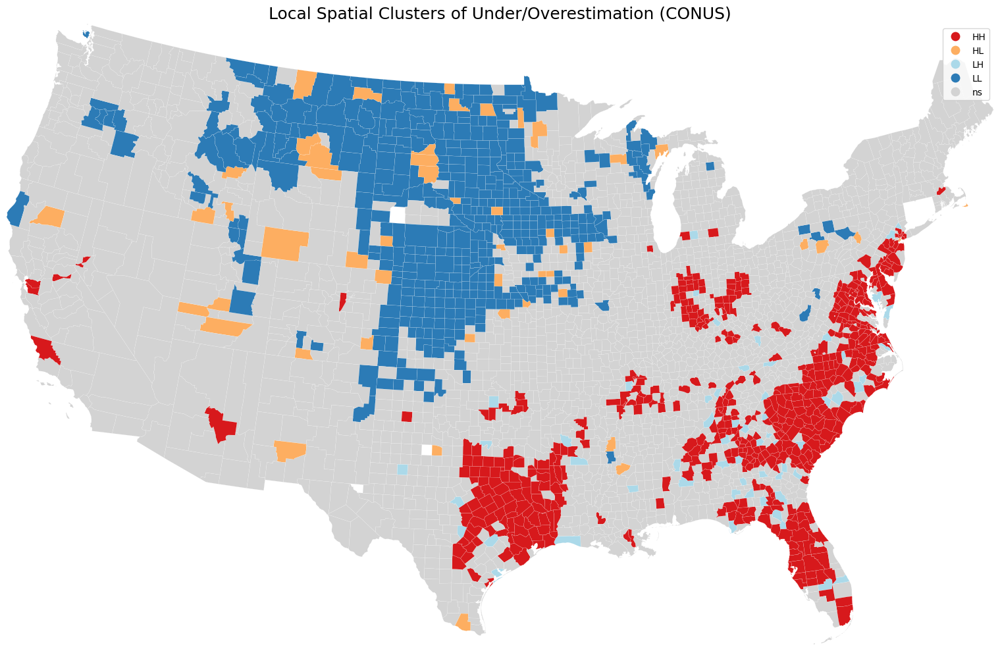

Global Moran’s I: 0.5172614306419536 p: 0.0001


In [86]:
import libpysal, esda
from splot.esda import lisa_cluster
import matplotlib.pyplot as plt

conus = geo_df[~geo_df["STATE"].isin(["02", "15", "72"])].copy()

conus = conus.to_crs(5070)

w = libpysal.weights.Queen.from_dataframe(conus, use_index=True)
w.transform = "r"
lisa = esda.Moran_Local(conus["bias"], w)

fig, ax = plt.subplots(figsize=(16, 10))
lisa_cluster(lisa, conus, ax=ax, legend=True, p=0.05)
minx, miny, maxx, maxy = conus.total_bounds
ax.set_xlim(minx, maxx); ax.set_ylim(miny, maxy)
ax.set_title("Local Spatial Clusters of Under/Overestimation (CONUS)", fontsize=18)
ax.set_axis_off()
plt.tight_layout()
plt.show()

moran = esda.Moran(conus["bias"].values, w, permutations=9999)

print("Global Moran’s I:", moran.I, "p:", moran.p_sim)